Copyright (c) Meta Platforms, Inc. and affiliates.
All rights reserved.

This source code is licensed under the license found in the
LICENSE file in the root directory of this source tree.

The project is CC-BY-NC licensed, as found in the LICENSE file of the github.

# Loading Stable Signature's pre-trained HiDDeN model

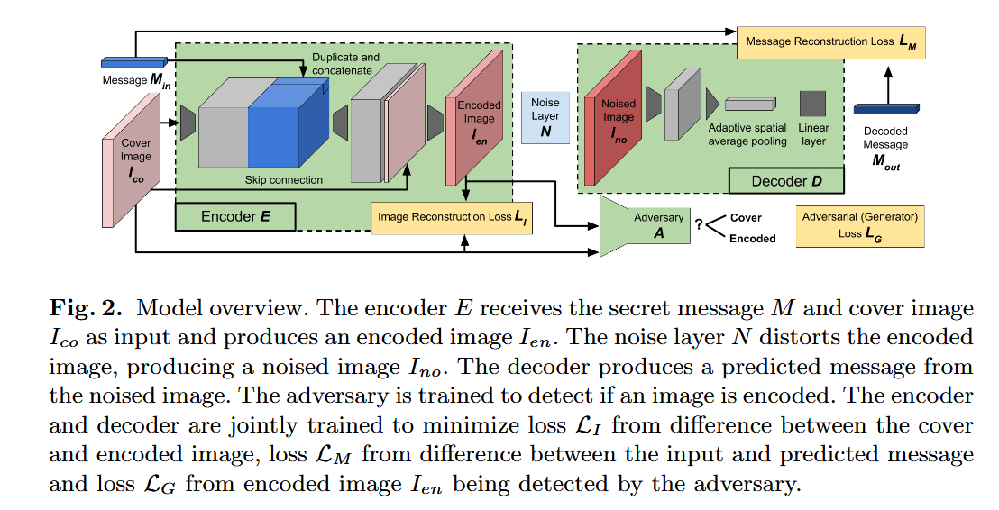

Clone repo:

In [ ]:
!git clone https://github.com/facebookresearch/stable_signature.git
%cd stable_signature/hidden

Cloning into 'stable_signature'...
remote: Enumerating objects: 187, done.
remote: Counting objects: 100% (46/46), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 187 (delta 28), reused 19 (delta 18), pack-reused 141 (from 1)
Receiving objects: 100% (187/187), 9.28 MiB | 8.07 MiB/s, done.
Resolving deltas: 100% (39/39), done.
/content/stable_signature/hidden


Install requirements:

In [ ]:
!pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.4/69.4 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 20.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 705.7/705.7 kB 16.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 21.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.3/24.3 MB 37.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.2/13.2 MB 27.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 19.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 28.7 MB/s eta 0:00:00
  Created wheel for iopath: filename=iopath-0.1.10-py3-none-any.whl size=31528 sha256=79d5688972ea8b8e620c6d433a1afbb7fdba17b2959f9434ba591498b304fa35
  Stored in direc

In [ ]:
# Resolve issue in Augly library
!sudo apt-get install python3-magic

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  python3-magic
0 upgraded, 1 newly installed, 0 to remove and 49 not upgraded.
Need to get 12.6 kB of archives.
After this operation, 52.2 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 python3-magic all 2:0.4.24-2 [12.6 kB]
Fetched 12.6 kB in 0s (43.1 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package python3-magic.
(Reading database ... 123635 files and dir

Imports

In [ ]:
import torch
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from skimage.metrics import peak_signal_noise_ratio

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# you should run this notebook in the root directory of the hidden project for the following imports to work
# %cd ..
from models import HiddenEncoder, HiddenDecoder, EncoderWithJND, EncoderDecoder
from attenuations import JND

In [ ]:
def msg2str(msg):
    return "".join([('1' if el else '0') for el in msg])

def str2msg(str):
    return [True if el=='1' else False for el in str]

### Load and build models

The watermark signal can be rescaled with a factor `scaling_w`.

We use the just noticeable difference (JND) heatmap presented in https://github.com/facebookresearch/active_indexing to mask the watermark signal in areas where the eye is sensitive to changes.
This allows to impose perceptual constraint, in case we want to use the trained encoder to watermark images.

In [ ]:
class Params():
    def __init__(self, encoder_depth:int, encoder_channels:int, decoder_depth:int, decoder_channels:int, num_bits:int,
                attenuation:str, scale_channels:bool, scaling_i:float, scaling_w:float):
        # encoder and decoder parameters
        self.encoder_depth = encoder_depth
        self.encoder_channels = encoder_channels
        self.decoder_depth = decoder_depth
        self.decoder_channels = decoder_channels
        self.num_bits = num_bits
        # attenuation parameters
        self.attenuation = attenuation
        self.scale_channels = scale_channels
        self.scaling_i = scaling_i
        self.scaling_w = scaling_w

NORMALIZE_IMAGENET = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
UNNORMALIZE_IMAGENET = transforms.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225], std=[1/0.229, 1/0.224, 1/0.225])
default_transform = transforms.Compose([transforms.ToTensor(), NORMALIZE_IMAGENET])

params = Params(
    encoder_depth=4, encoder_channels=64, decoder_depth=8, decoder_channels=64, num_bits=48,
    attenuation="jnd", scale_channels=False, scaling_i=1, scaling_w=1.5
)

decoder = HiddenDecoder(
    num_blocks=params.decoder_depth,
    num_bits=params.num_bits,
    channels=params.decoder_channels
)
encoder = HiddenEncoder(
    num_blocks=params.encoder_depth,
    num_bits=params.num_bits,
    channels=params.encoder_channels
)
attenuation = JND(preprocess=UNNORMALIZE_IMAGENET) if params.attenuation == "jnd" else None
encoder_with_jnd = EncoderWithJND(
    encoder, attenuation, params.scale_channels, params.scaling_i, params.scaling_w
)

In [ ]:
ckpt_path = "ckpts/hidden_replicate.pth"

state_dict = torch.load(ckpt_path, map_location='cpu')['encoder_decoder']
encoder_decoder_state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
encoder_state_dict = {k.replace('encoder.', ''): v for k, v in encoder_decoder_state_dict.items() if 'encoder' in k}
decoder_state_dict = {k.replace('decoder.', ''): v for k, v in encoder_decoder_state_dict.items() if 'decoder' in k}

encoder.load_state_dict(encoder_state_dict)
decoder.load_state_dict(decoder_state_dict)

encoder_with_jnd = encoder_with_jnd.to(device).eval()
decoder = decoder.to(device).eval()

<ipython-input-7-bf06d632ea4e>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(ckpt_path, map_location='cpu')['encoder_decoder']


# Distortions

In [ ]:
msg_ori = torch.Tensor(str2msg("111010110101000001010111010011010100010000100111")).unsqueeze(0)
msg = 2 * msg_ori.type(torch.float) - 1

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/mirflickr25k.zip -d /content/sample_data/

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: /content/sample_data/mirflickr/meta/tags_raw/tags5499.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags55.txt  
  inflating: /content/sample_data/mirflickr/meta/tags_raw/tags550.txt  
  inflating: /content/sample_data/mirflickr/meta/tags_raw/tags5500.txt  
  inflating: /content/sample_data/mirflickr/meta/tags_raw/tags5501.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags5502.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags5503.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags5504.txt  
  inflating: /content/sample_data/mirflickr/meta/tags_raw/tags5505.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags5506.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags5507.txt  
 extracting: /content/sample_data/mirflickr/meta/tags_raw/tags5508.txt  
  inflating: /content/sample_data/mirflickr/meta/tags_raw/t

In [ ]:
images = [f'/content/sample_data/mirflickr/im{idx + 1}.jpg' for idx in range(6)]

pt_images = []
for image in images:
  img = Image.open(image).convert('RGB')
  img = img.resize((512, 512), Image.BICUBIC)
  img_pt = default_transform(img).unsqueeze(0).to(device)
  pt_images.append(img_pt)

In [ ]:
watermarked_images = []
for image in pt_images:
    img_w = encoder_with_jnd(image, msg)
    clip_img = torch.clamp(UNNORMALIZE_IMAGENET(img_w), 0, 1)
    clip_img = torch.round(255 * clip_img)/255
    clip_img = transforms.ToPILImage()(clip_img.squeeze(0).cpu())
    watermarked_images.append(np.array(clip_img))


In [ ]:
def plot_side_by_side(a, b, i):
    """Plots a[i] and b[i] side-by-side using matplotlib.pyplot."""

    fig, axs = plt.subplots(1, 3, figsize=(10, 5))

    image_pil = Image.fromarray(a[i])
    resized_image_pil = image_pil.resize((512, 512), Image.BICUBIC)
    resized_image = np.array(resized_image_pil)

    axs[0].imshow(resized_image)
    axs[0].set_title(f'original image [{i}]')
    axs[0].axis('off')

    axs[1].imshow(b[i])
    axs[1].set_title(f'watermarked image [{i}]')
    axs[1].axis('off')

    diff = np.abs(np.asarray(resized_image).astype(int) - np.asarray(b[i]).astype(int)) / 255 * 10
    axs[2].imshow(diff)
    axs[2].set_title(f'difference image [{i}]')
    axs[2].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
original_images = []
for image in images:
  img = Image.open(image).convert('RGB')
  img = img.resize((512, 512), Image.BICUBIC)
  original_images.append(np.array(img))

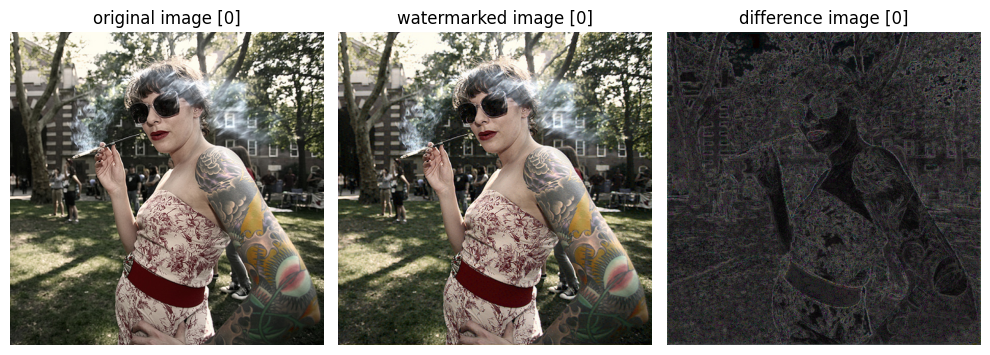

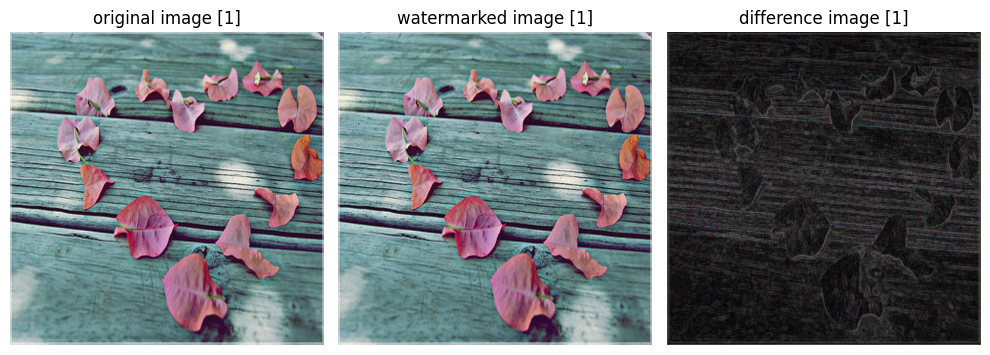

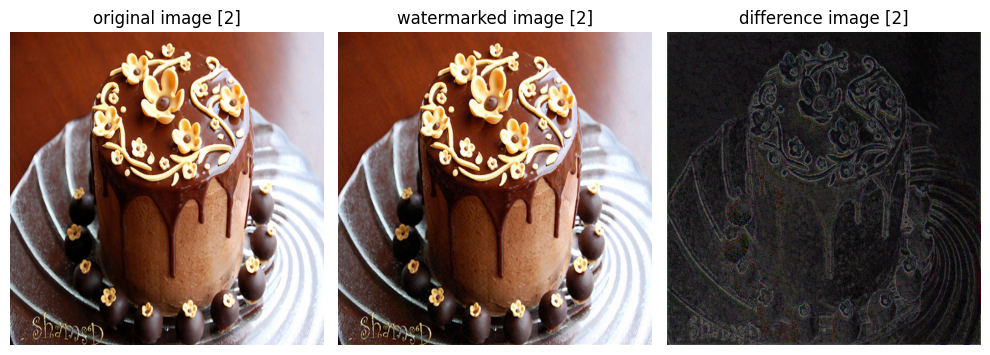

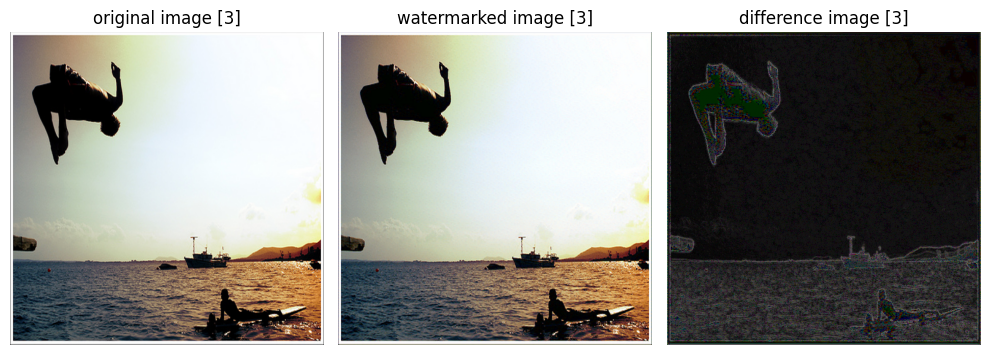

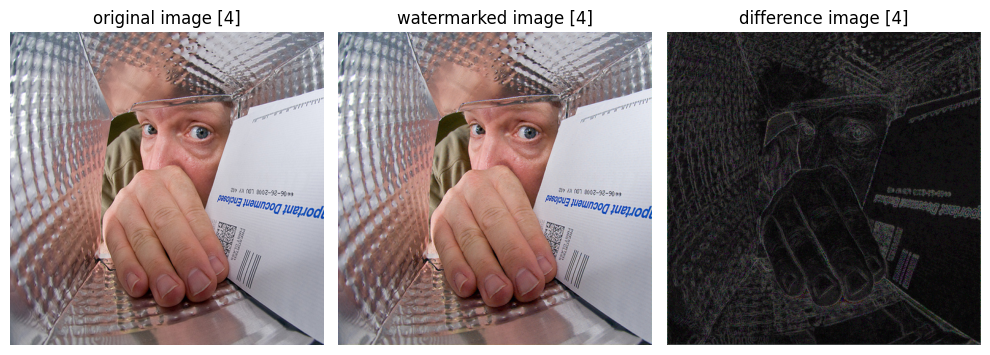

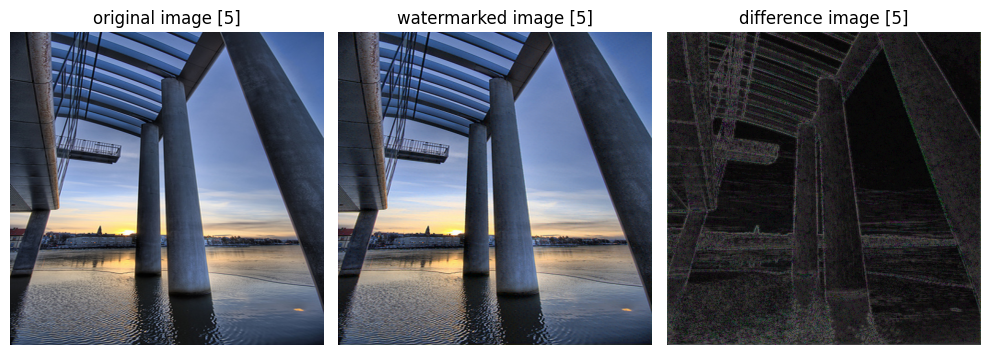

In [ ]:
original_images = [np.array(Image.open(image).convert('RGB')) for image in images]
for i in range(6):
    plot_side_by_side(original_images, watermarked_images, i)

# influence of coded message

## zero string message

In [ ]:
msg_ori_1 = torch.Tensor(str2msg("000000000000000000000000000000000000000000000000")).unsqueeze(0)
msg_1 = 2 * msg_ori.type(torch.float) - 1

msg_ori_2 = torch.Tensor(str2msg("111111111111111111111111111111111111111111111111")).unsqueeze(0)
msg_2 = 2 * msg_ori.type(torch.float) - 1


In [ ]:
def plot_side_by_side(a, b, i):
    """Plots a[i] and b[i] side-by-side using matplotlib.pyplot."""

    fig, axs = plt.subplots(1, 3, figsize=(10, 5))

    axs[0].imshow(a[i])
    axs[0].set_title(f'original image [{i}]')
    axs[0].axis('off')

    axs[1].imshow(b[i])
    axs[1].set_title(f'watermarked image [{i}]')
    axs[1].axis('off')

    diff = np.abs(np.asarray(a[i]).astype(int) - np.asarray(b[i]).astype(int)) / 255 * 10
    axs[2].imshow(diff)
    axs[2].set_title(f'difference image [{i}]')
    axs[2].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
#msg_ori_1 = torch.randint(0, 2, (1, params.num_bits), device=device).bool()
msg_ori_1 = torch.Tensor(str2msg("000000000000000000000000000000000000000000000000")).unsqueeze(0)
msg_1 = 2 * msg_ori_1.type(torch.float) - 1

#msg_ori_2 = torch.randint(0, 2, (1, params.num_bits), device=device).bool()
msg_ori_2 = torch.Tensor(str2msg("111111111111111111111111111111111111111111111111")).unsqueeze(0)
msg_2 = 2 * msg_ori_2.type(torch.float) - 1


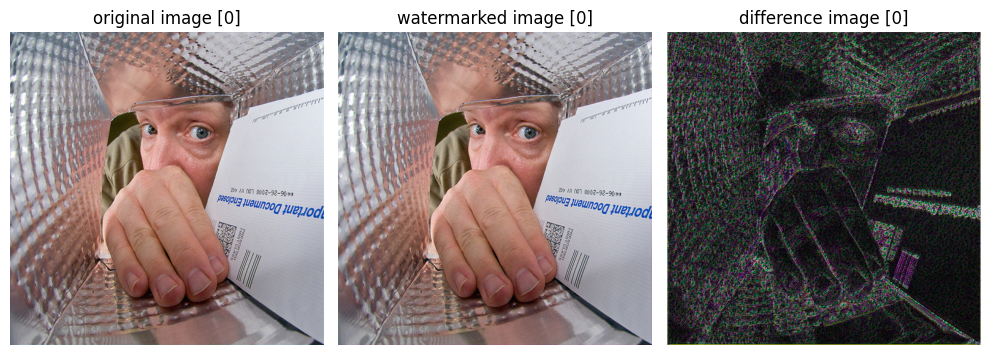

In [ ]:
image = pt_images[4]

img_w = encoder_with_jnd(image, msg_1)
clip_img = torch.clamp(UNNORMALIZE_IMAGENET(img_w), 0, 1)
clip_img = torch.round(255 * clip_img)/255
clip_img = transforms.ToPILImage()(clip_img.squeeze(0).cpu())
watermarked_images_1 = np.array(clip_img)

img_w = encoder_with_jnd(image, msg_2)
clip_img = torch.clamp(UNNORMALIZE_IMAGENET(img_w), 0, 1)
clip_img = torch.round(255 * clip_img)/255
clip_img = transforms.ToPILImage()(clip_img.squeeze(0).cpu())
watermarked_images_2 = np.array(clip_img)

original_images = [np.array(Image.open(image).convert('RGB')) for image in images]
plot_side_by_side([watermarked_images_1], [watermarked_images_2], 0)

In [ ]:
diff = np.abs(np.asarray(watermarked_images_2[0]).astype(int) - np.asarray(watermarked_images_1[0]).astype(int)) / 255 * 10

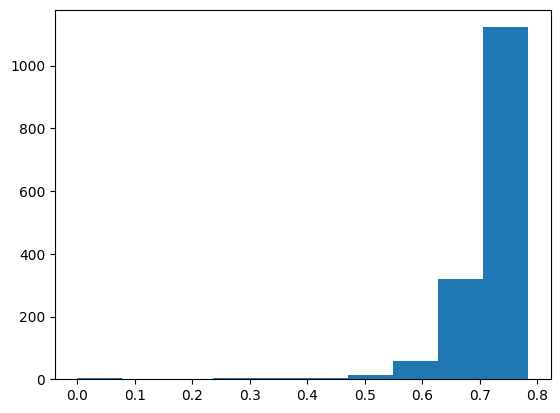

In [ ]:
plt.hist(diff.flatten());

In [ ]:
def replace_bit(bit_string, i):
    """Replaces the ith bit of a bit string with 1."""
    bit_list = list(bit_string)
    if bit_list[i] == '1':
        bit_list[i] = '0'
    else:
        bit_list[i] = '1'
    modified_bit_string = "".join(bit_list)
    return modified_bit_string

def plot_difference_in_bits(image, str0="000000000000000000000000000000000000000000000000"):
    """Plots a[i] and b[i] side-by-side using matplotlib.pyplot."""

    diffs = []

    fig, axs = plt.subplots(8, 6, figsize=(30, 40))
    axs = axs.flatten()

    msg_ori_1 = torch.Tensor(str2msg(str0)).unsqueeze(0)
    msg_1 = 2 * msg_ori_1.type(torch.float) - 1

    img_w = encoder_with_jnd(image, msg_1)
    clip_img = torch.clamp(UNNORMALIZE_IMAGENET(img_w), 0, 1)
    clip_img = torch.round(255 * clip_img)/255
    clip_img_0 = transforms.ToPILImage()(clip_img.squeeze(0).cpu())

    for i in range(48):
        str1 = replace_bit(str0, i)
        msg_ori_2 = torch.Tensor(str2msg(str1)).unsqueeze(0)
        msg_2 = 2 * msg_ori_2.type(torch.float) - 1

        img_w = encoder_with_jnd(image, msg_2)
        clip_img = torch.clamp(UNNORMALIZE_IMAGENET(img_w), 0, 1)
        clip_img = torch.round(255 * clip_img)/255
        clip_img_1 = transforms.ToPILImage()(clip_img.squeeze(0).cpu())

        diff = np.abs(np.asarray(clip_img_1).astype(int) - np.asarray(clip_img_0).astype(int)) / 255 * 10
        diffs.append(diff)

        axs[i].imshow(diff)
        axs[i].set_title(f'difference image for bit [{i}]')
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()
    return diffs

### image 4

In [ ]:
diffs = plot_difference_in_bits(pt_images[4], "000000000000000000000000000000000000000000000000")

In [ ]:
import seaborn as sns

def heatmap_diff_sums(diffs, image_num):
    diffs = np.array(diffs)
    diff_sums = np.array([diff.flatten().sum() for diff in diffs]).reshape((6, 8))


    plt.figure(figsize=(7, 7))

    ax = sns.heatmap(diff_sums, fmt=".0f",  cmap="YlGnBu")

    num_rows, num_cols = diff_sums.shape

    for i in range(num_rows):
        for j in range(num_cols):
            ax.text(
                j + 0.5,
                i + 0.5,
                str(i * num_cols + j),
                ha="center",
                va="center",
                color="black",
                fontsize=8,
            )
    plt.title(f'image [{image_num}], sums of bit pos difference from zeros string')
    plt.show()

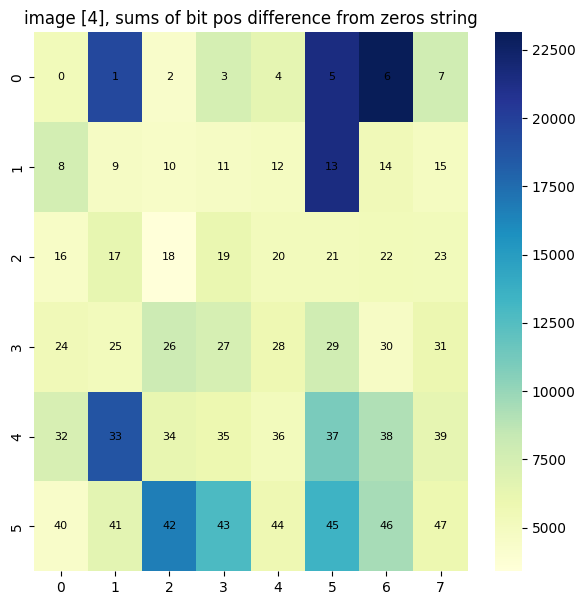

In [ ]:
heatmap_diff_sums(diffs, 4)

### image 0

In [ ]:
diffs = plot_difference_in_bits(pt_images[0], "000000000000000000000000000000000000000000000000")

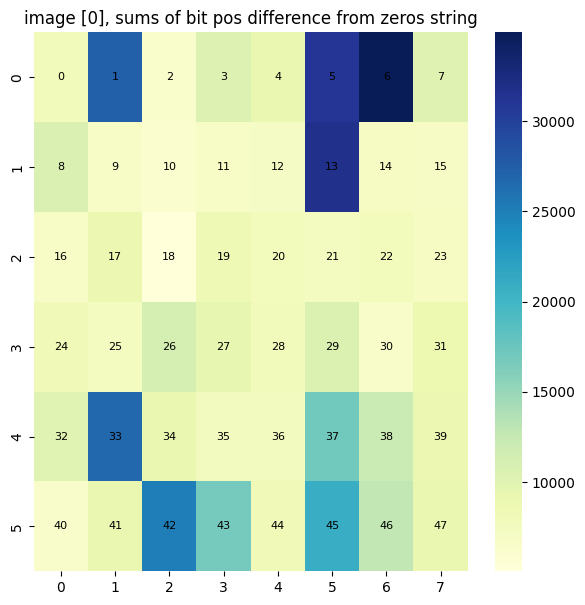

In [ ]:
heatmap_diff_sums(diffs, 0)

### image 1

In [ ]:
diffs = plot_difference_in_bits(pt_images[1], "000000000000000000000000000000000000000000000000")

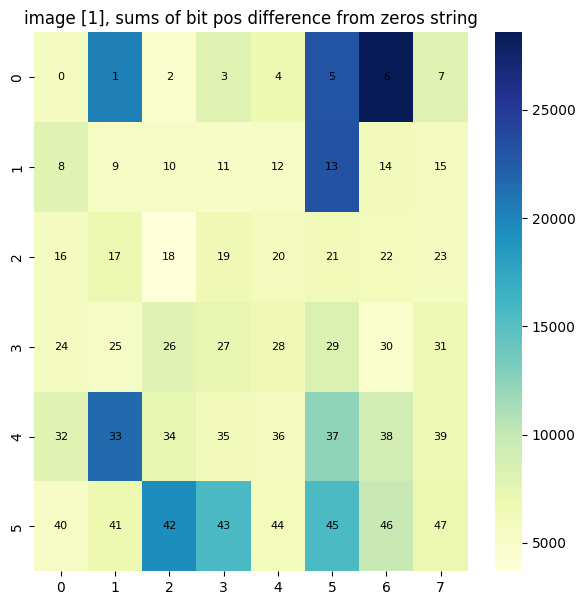

In [ ]:
heatmap_diff_sums(diffs, 1)

### image 2

In [ ]:
diffs = plot_difference_in_bits(pt_images[2], "000000000000000000000000000000000000000000000000")

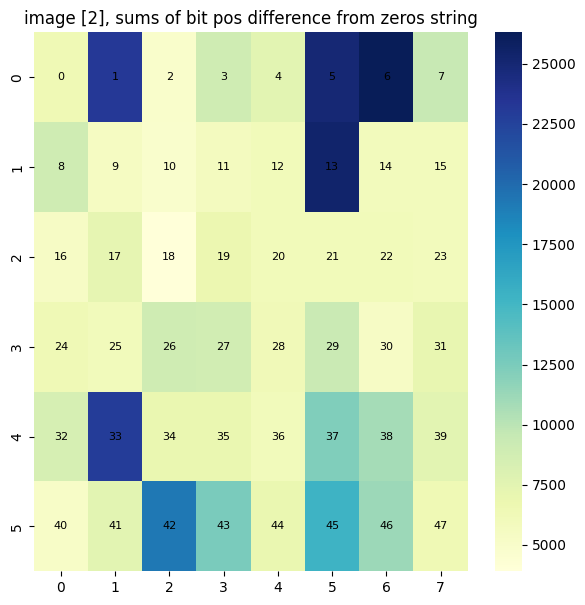

In [ ]:
heatmap_diff_sums(diffs, 2)

### image 3

In [ ]:
diffs = plot_difference_in_bits(pt_images[3], "000000000000000000000000000000000000000000000000")

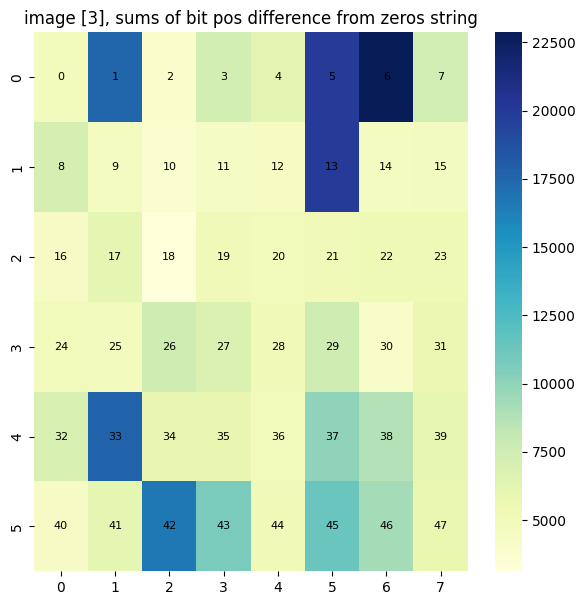

In [ ]:
heatmap_diff_sums(diffs, 3)

### image 5

In [ ]:
diffs = plot_difference_in_bits(pt_images[5], "000000000000000000000000000000000000000000000000")

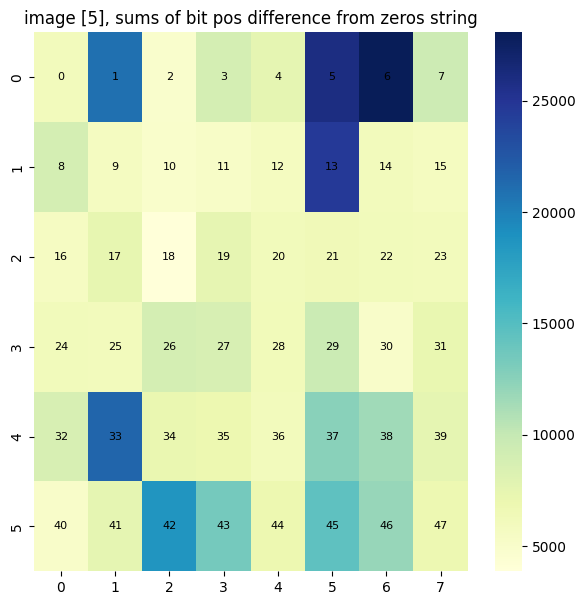

In [ ]:
heatmap_diff_sums(diffs, 5)

## different message

In [ ]:
msg_ori = torch.randint(0, 2, (1, params.num_bits), device=device).numpy()
bit_string = "".join(str(bit) for bit in msg_ori.flatten())
print(bit_string)

111011011100001100010111001001001011111101001010


### image 4

In [ ]:
diffs = plot_difference_in_bits(pt_images[4], bit_string)

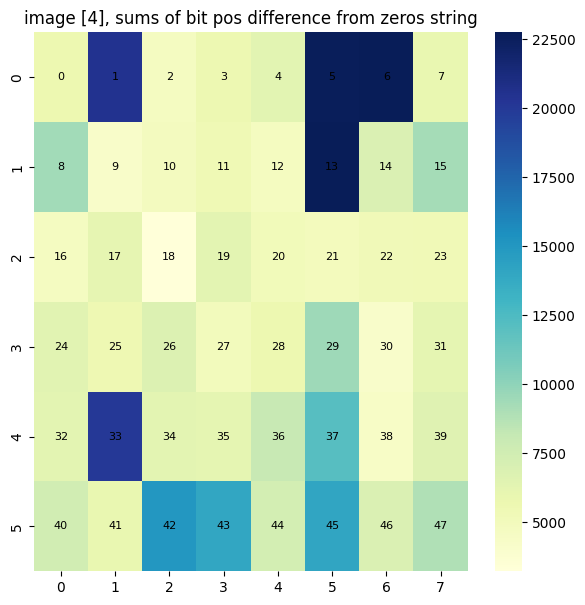

In [ ]:
heatmap_diff_sums(diffs, 4)

### image 0

In [ ]:
diffs = plot_difference_in_bits(pt_images[0], bit_string)

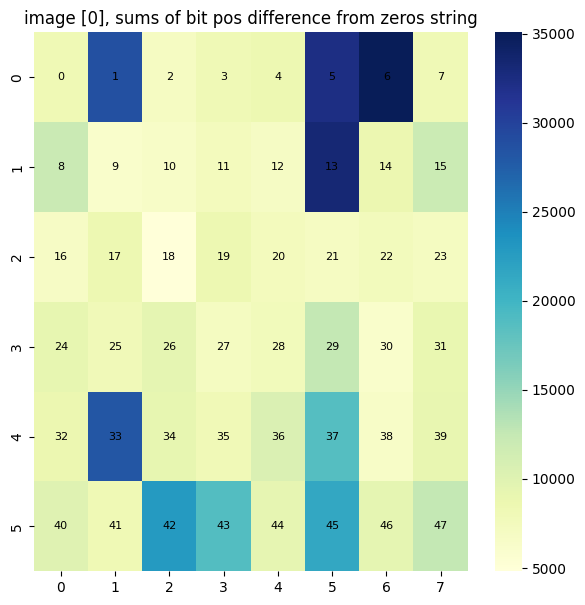

In [ ]:
heatmap_diff_sums(diffs, 0)

### image 1

In [ ]:
diffs = plot_difference_in_bits(pt_images[1], bit_string)

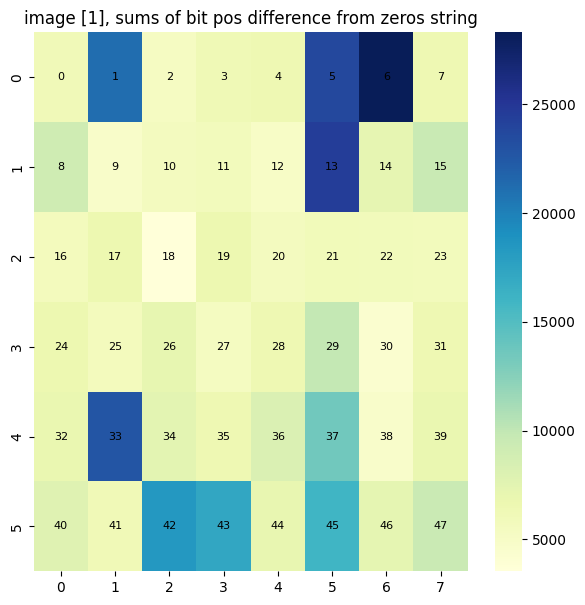

In [ ]:
heatmap_diff_sums(diffs, 1)

### image 2

In [ ]:
diffs = plot_difference_in_bits(pt_images[2], bit_string)

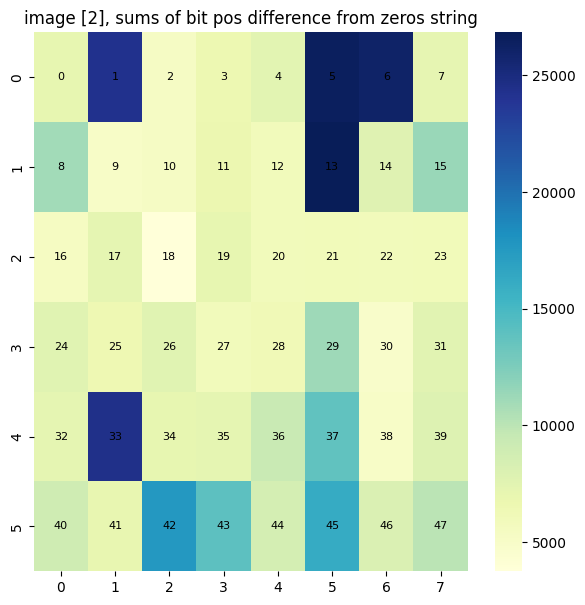

In [ ]:
heatmap_diff_sums(diffs, 2)

### image 3

In [ ]:
diffs = plot_difference_in_bits(pt_images[3], bit_string)

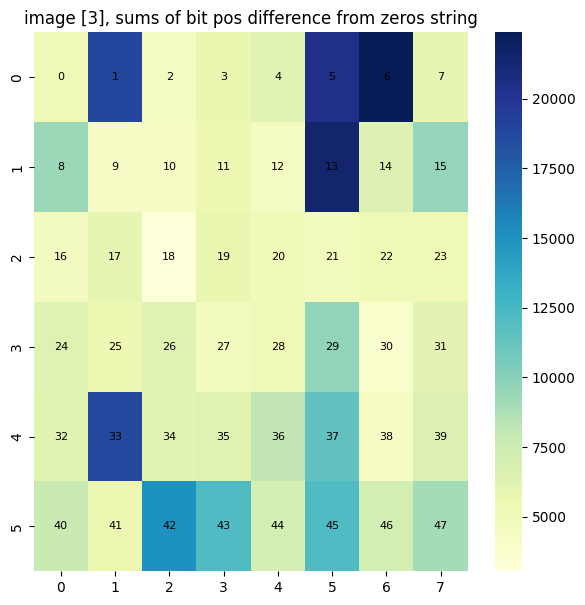

In [ ]:
heatmap_diff_sums(diffs, 3)

### image 5

In [ ]:
diffs = plot_difference_in_bits(pt_images[5], bit_string)

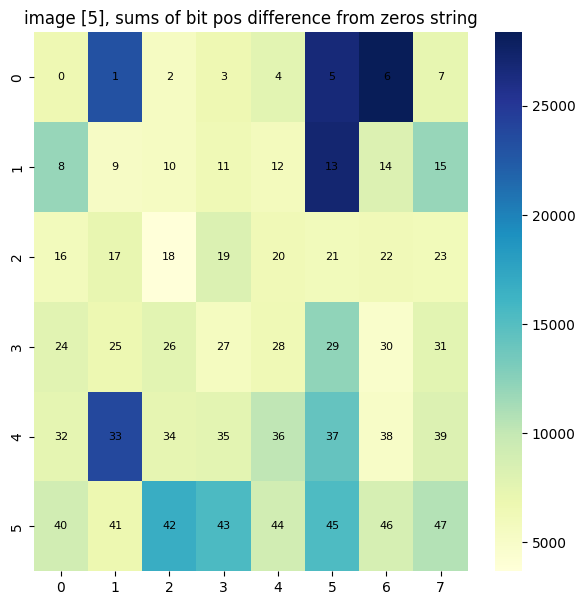

In [ ]:
heatmap_diff_sums(diffs, 5)

# Decoding

In [ ]:
def calculate_similarity(arr1, arr2):
  """Calculates the similarity between two arrays using Hamming distance."""
  if arr1.shape != arr2.shape:
    raise ValueError("Arrays must have the same shape for comparison.")

  hamming_distance = np.sum(arr1 != arr2)

  similarity = (arr1.size - hamming_distance) / arr1.size * 100

  return similarity

In [ ]:
decoded_secrets_stable_sig = []
for clip_img in watermarked_images:
    ft = decoder(default_transform(clip_img).unsqueeze(0).to(device))
    decoded_msg = ft > 0
    decoded_secrets_stable_sig.append(decoded_msg.squeeze(0).cpu().numpy().astype(int))

In [ ]:
for i in range(6):
    sim_idx = calculate_similarity(decoded_secrets_stable_sig[i], msg_ori[0].numpy())
    print(f"{sim_idx:.3f}%")

100.000%
95.833%
100.000%
100.000%
100.000%
100.000%


# Blur distortion

In [ ]:
import cv2

blurred_images_7 = np.array([cv2.GaussianBlur(image, (7, 7), 0) for image in watermarked_images])
blurred_images_15 = np.array([cv2.GaussianBlur(image, (15, 15), 0) for image in watermarked_images])
blurred_images_21 = np.array([cv2.GaussianBlur(image, (21, 21), 0) for image in watermarked_images])

In [ ]:
def plot_side_by_side(a, b, damaged_light, damaged_medium, damaged_heavy, i):
    """Plots a[i] and b[i] side-by-side using matplotlib.pyplot."""

    fig, axs = plt.subplots(1, 5, figsize=(15, 5))

    axs[0].imshow(a[i])
    axs[0].set_title(f'original image [{i}]')
    axs[0].axis('off')

    axs[1].imshow(b[i])
    axs[1].set_title(f'watermarked image [{i}]')
    axs[1].axis('off')

    axs[2].imshow(damaged_light[i])
    axs[2].set_title(f'lightly damaged w-image [{i}]')
    axs[2].axis('off')

    axs[3].imshow(damaged_medium[i])
    axs[3].set_title(f'moderately damaged w-image [{i}]')
    axs[3].axis('off')

    axs[4].imshow(damaged_heavy[i])
    axs[4].set_title(f'heavily damaged w-image [{i}]')
    axs[4].axis('off')

    plt.tight_layout()
    plt.show()

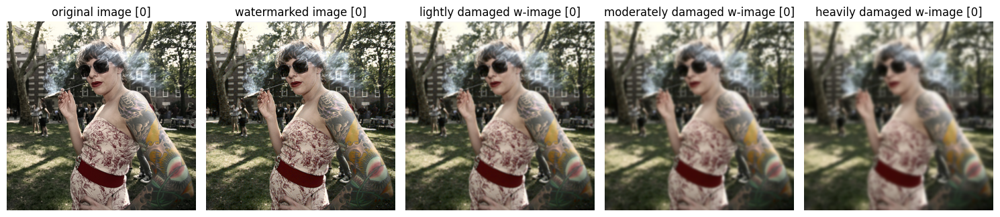

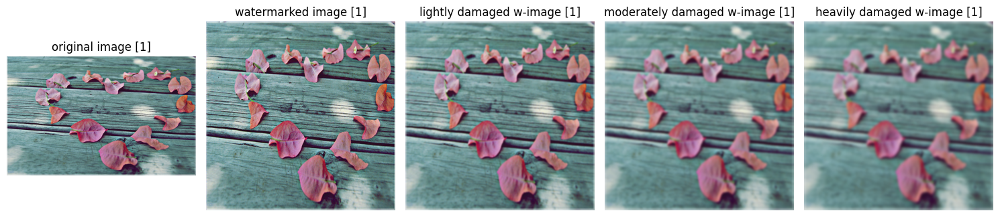

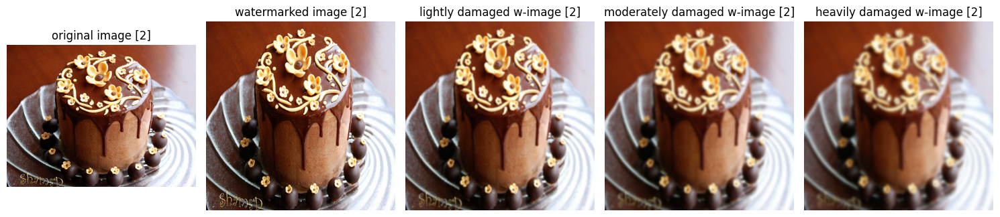

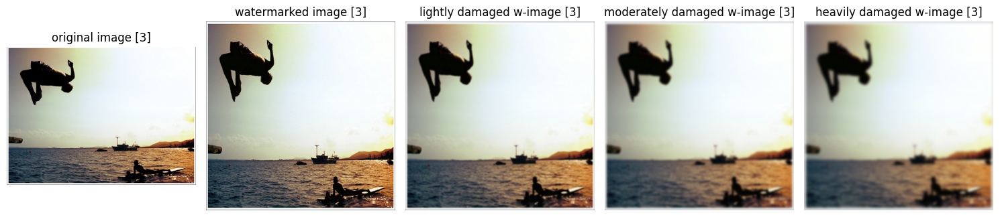

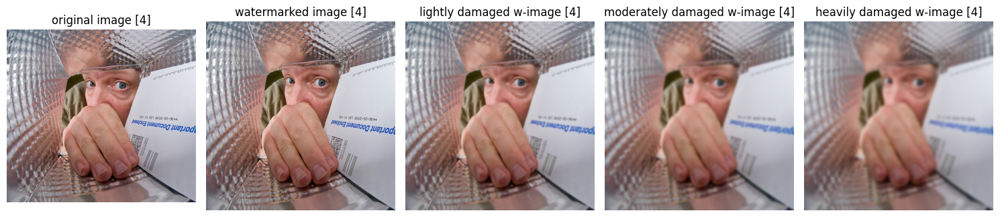

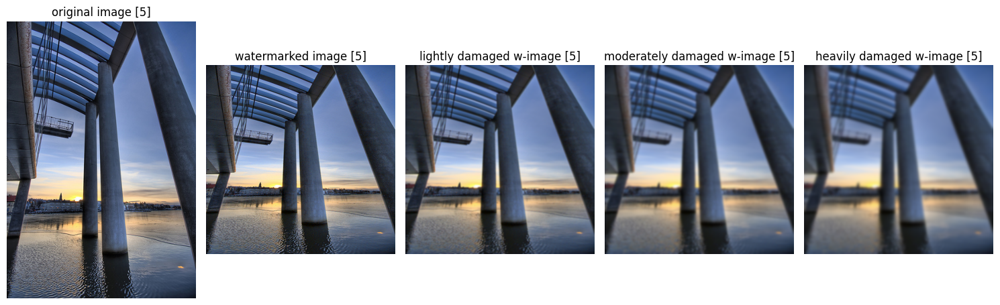

In [ ]:
for i in range(6):
    plot_side_by_side(original_images, watermarked_images, blurred_images_7, blurred_images_15, blurred_images_21, i)

In [ ]:
damages = [blurred_images_7, blurred_images_15, blurred_images_21]

In [ ]:
decoded_dict = {}

for i, name in enumerate(['light damage', 'medium damage', 'heavy damage']):
    print('\n\n', name)
    decoded_secrets_stable_sig = []
    decoded_dict[name] = []
    for clip_img in damages[i]:
        ft = decoder(default_transform(clip_img).unsqueeze(0).to(device))
        decoded_msg = ft > 0
        decoded_msg = decoded_msg.squeeze(0).cpu().numpy().astype(int)

        decoded_dict[name].append(decoded_msg)

        sim_idx = calculate_similarity(decoded_msg, msg_ori[0].numpy())
        print(f"{sim_idx:.3f}%")



 light damage
66.667%
58.333%
66.667%
60.417%
68.750%
66.667%


 medium damage
47.917%
50.000%
58.333%
58.333%
58.333%
60.417%


 heavy damage
50.000%
56.250%
58.333%
60.417%
60.417%
60.417%


In [ ]:
def plot_decoding_errors(decoded_dict, effect):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    for i, name in enumerate(['light damage', 'medium damage', 'heavy damage']):

        cum_sum_arr = []
        for arr in decoded_dict[name]:
            cum_sum_arr.append(np.logical_xor(arr, msg_ori[0].numpy()).astype(int))

        errors_sum_array = np.array(cum_sum_arr).sum(axis=0)
        cbar = False
        if i == 2:
            cbar = True
        axes[i].set_title(name)
        sns.heatmap(errors_sum_array.reshape(6, 8), ax=axes[i], cbar=cbar, cmap="YlGnBu")
        num_rows, num_cols = 6, 8

        for k in range(num_rows):
            for j in range(num_cols):
                axes[i].text(
                    j + 0.5,
                    k + 0.5,
                    str(k * num_cols + j),
                    ha="center",
                    va="center",
                    color="black",
                    fontsize=8,
                )
    plt.suptitle(effect)
    plt.show()

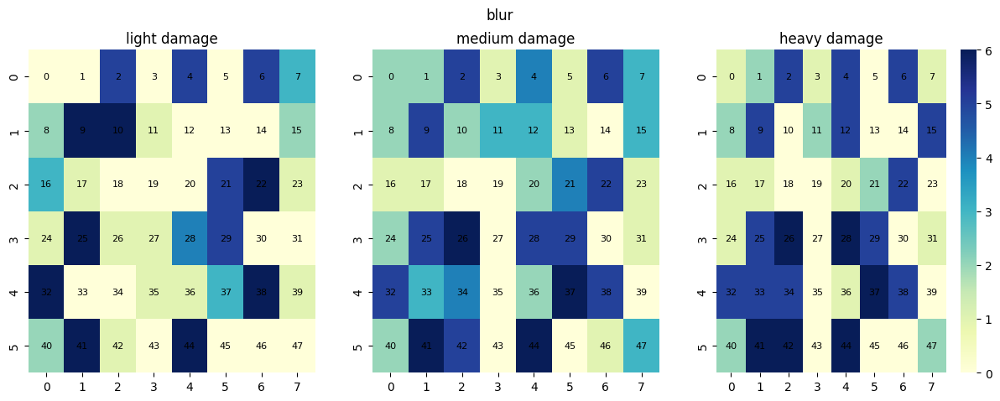

In [ ]:
plot_decoding_errors(decoded_dict, 'blur')

# Noise distortion

In [ ]:
watermarked_images = np.array(watermarked_images)

In [ ]:
noised_images = []

for noise_intensity in [0.1, 0.4, 0.6]:
    noise = np.random.normal(0, noise_intensity, watermarked_images.shape)
    temp_watermarked_images = watermarked_images.copy() / 255
    noisy_image = np.clip(temp_watermarked_images + noise, 0, 1)
    noised_images.append(noisy_image)

In [ ]:
for i in range(6):
    plot_side_by_side(original_images, watermarked_images, noised_images[0], noised_images[1], noised_images[2], i)

In [ ]:
decoded_dict = {}

for i, name in enumerate(['light damage', 'medium damage', 'heavy damage']):
    print('\n\n', name)
    decoded_secrets_stable_sig = []
    decoded_dict[name] = []
    for j in range(6):
        clip_img = noised_images[i][j]
        ft = decoder(default_transform(clip_img.astype(np.float32)).unsqueeze(0).to(device))
        decoded_msg = ft > 0
        decoded_msg = decoded_msg.squeeze(0).cpu().numpy().astype(int)

        decoded_dict[name].append(decoded_msg)

        sim_idx = calculate_similarity(decoded_msg, msg_ori[0].numpy())
        print(f"{sim_idx:.3f}%")



 light damage
56.250%
58.333%
52.083%
47.917%
47.917%
52.083%


 medium damage
47.917%
50.000%
45.833%
43.750%
47.917%
50.000%


 heavy damage
52.083%
54.167%
50.000%
45.833%
50.000%
52.083%


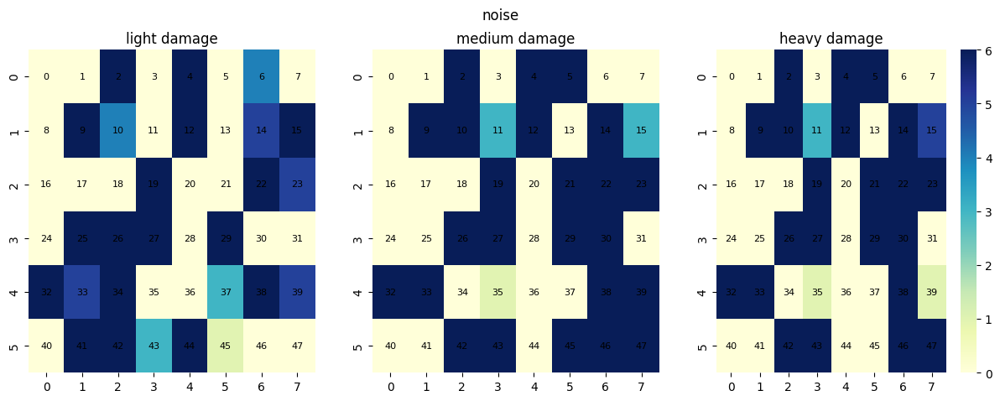

In [ ]:
plot_decoding_errors(decoded_dict, 'noise')

# Increased brightness

In [ ]:
def adjust_brightness(image, factor):
    temp_watermarked_images = image.copy() / 255
    return np.clip(temp_watermarked_images * factor, 0, 1)

distorted_images = [adjust_brightness(watermarked_images, factor=f) for f in [1.5, 3, 5]]

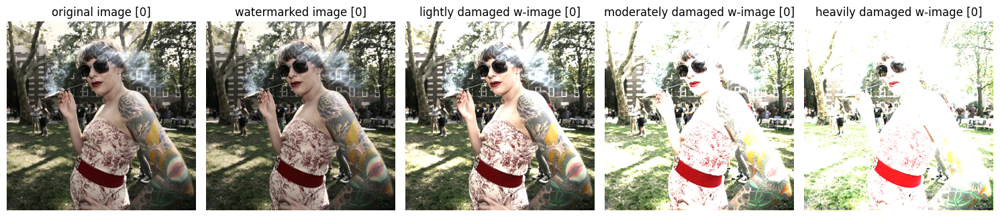

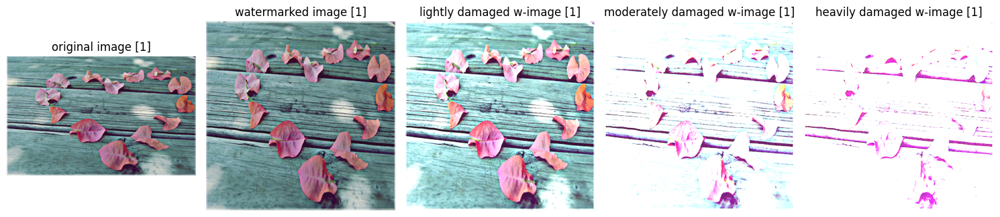

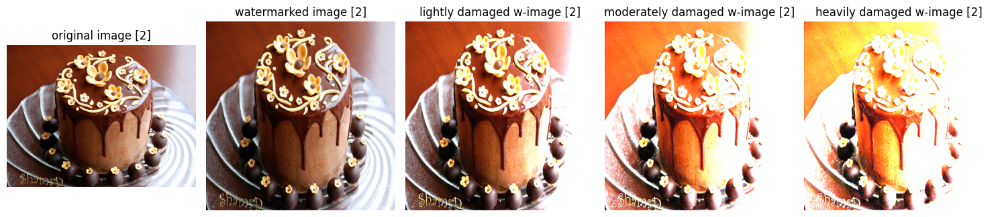

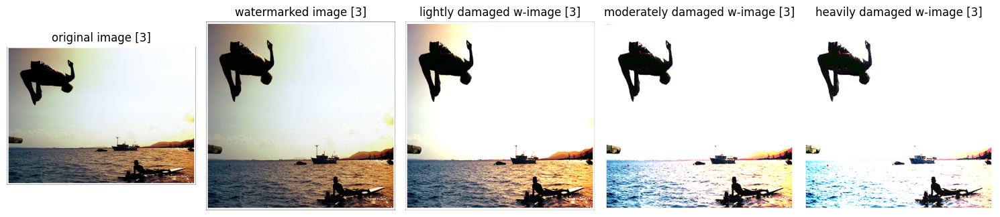

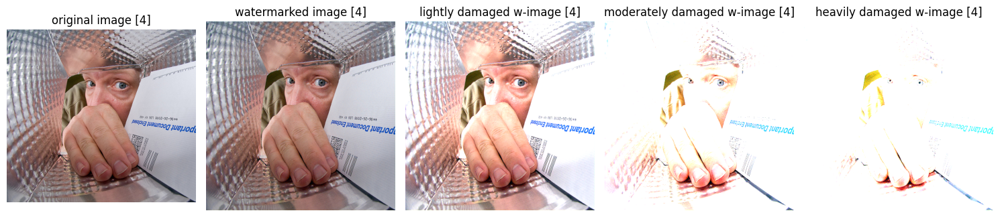

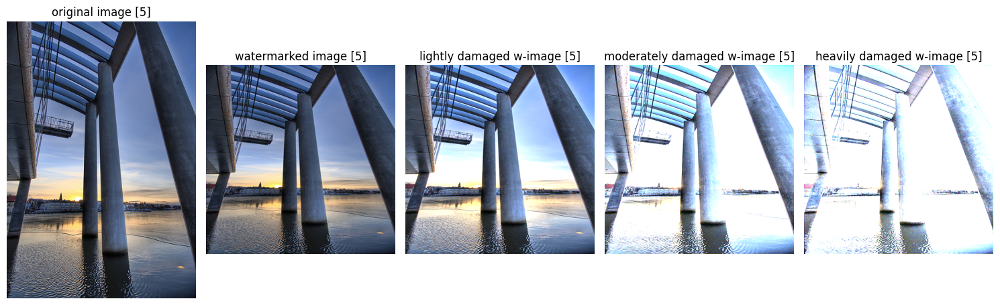

In [ ]:
for i in range(6):
    plot_side_by_side(original_images, watermarked_images, distorted_images[0], distorted_images[1], distorted_images[2], i)

In [ ]:
decoded_dict = {}

for i, name in enumerate(['light damage', 'medium damage', 'heavy damage']):
    print('\n\n', name)
    decoded_secrets_stable_sig = []
    decoded_dict[name] = []
    for j in range(6):
        clip_img = distorted_images[i][j]
        ft = decoder(default_transform(clip_img.astype(np.float32)).unsqueeze(0).to(device))
        decoded_msg = ft > 0
        decoded_msg = decoded_msg.squeeze(0).cpu().numpy().astype(int)

        decoded_dict[name].append(decoded_msg)

        sim_idx = calculate_similarity(decoded_msg, msg_ori[0].numpy())
        print(f"{sim_idx:.3f}%")



 light damage
100.000%
95.833%
100.000%
100.000%
100.000%
100.000%


 medium damage
97.917%
68.750%
100.000%
91.667%
83.333%
100.000%


 heavy damage
93.750%
66.667%
100.000%
83.333%
72.917%
97.917%


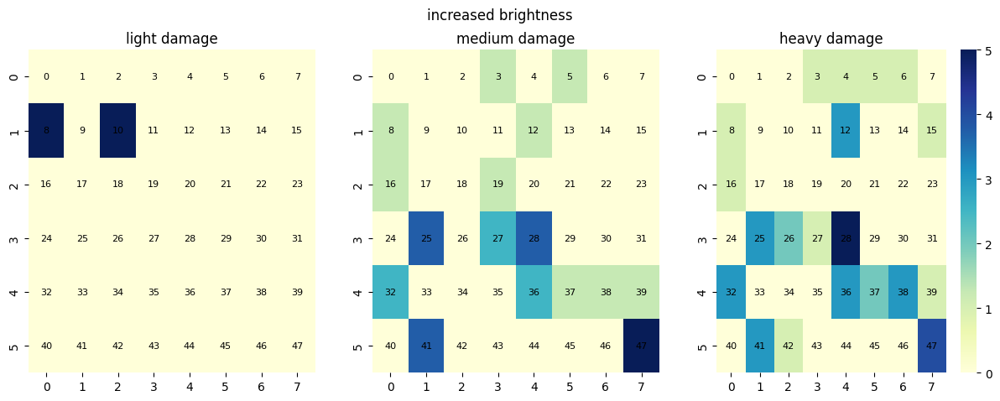

In [ ]:
plot_decoding_errors(decoded_dict, 'increased brightness')

# Geometric distortion

In [ ]:
def geometric_distortion(images, param):

  distorted_images = []
  for image in images:
    rows, cols, _ = image.shape
    M = cv2.getRotationMatrix2D((cols / 2, rows / 2), param, 1)
    rotated_image = cv2.warpAffine(image, M, (cols, rows))
    distorted_images.append(rotated_image)

  return np.stack(distorted_images)

In [ ]:
distorted_images = [geometric_distortion(watermarked_images, param) for param in [15, 30, 50]]

In [ ]:
for i in range(6):
    plot_side_by_side(original_images, watermarked_images, distorted_images[0], distorted_images[1], distorted_images[2], i)

In [ ]:
decoded_dict = {}

for i, name in enumerate(['light damage', 'medium damage', 'heavy damage']):
    print('\n\n', name)
    decoded_secrets_stable_sig = []
    decoded_dict[name] = []
    for j in range(6):
        clip_img = distorted_images[i][j]
        ft = decoder(default_transform(clip_img.astype(np.float32)).unsqueeze(0).to(device))
        decoded_msg = ft > 0
        decoded_msg = decoded_msg.squeeze(0).cpu().numpy().astype(int)

        decoded_dict[name].append(decoded_msg)

        sim_idx = calculate_similarity(decoded_msg, msg_ori[0].numpy())
        print(f"{sim_idx:.3f}%")



 light damage
50.000%
47.917%
50.000%
50.000%
50.000%
50.000%


 medium damage
52.083%
52.083%
52.083%
52.083%
50.000%
52.083%


 heavy damage
50.000%
52.083%
50.000%
50.000%
50.000%
52.083%


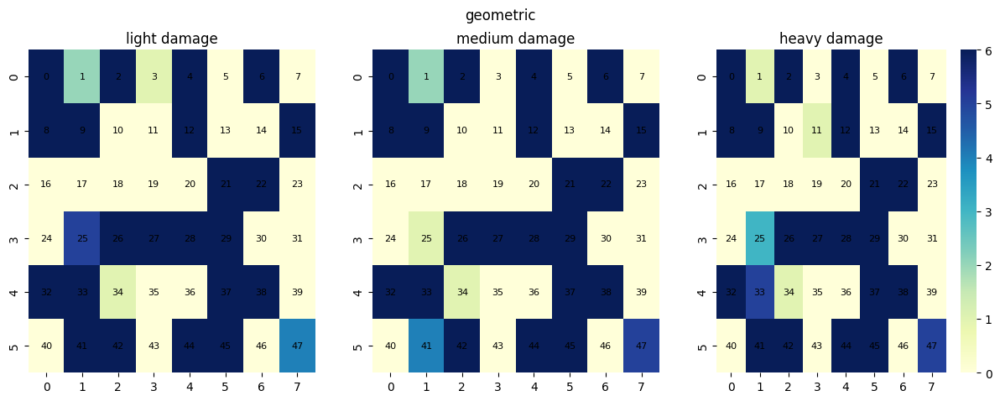

In [ ]:
plot_decoding_errors(decoded_dict, 'geometric')

# Compression artifacts

In [ ]:
import os

def apply_jpeg_compression(images, quality=50):
    distorted_images = []
    for i, image in enumerate(images):
        temp_file_path = f"temp_compressed_{i}.jpg"

        cv2.imwrite(temp_file_path, image, [int(cv2.IMWRITE_JPEG_QUALITY), quality])

        compressed_image = cv2.imread(temp_file_path)

        os.remove(temp_file_path)

        distorted_images.append(compressed_image)

    return np.stack(distorted_images)

In [ ]:
distorted_images = [apply_jpeg_compression(watermarked_images, quality=q) for q in [10, 5, 2]]

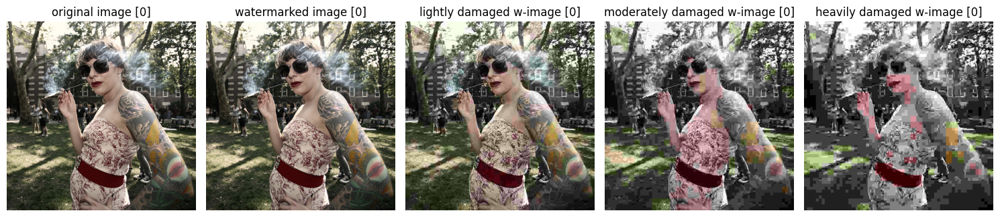

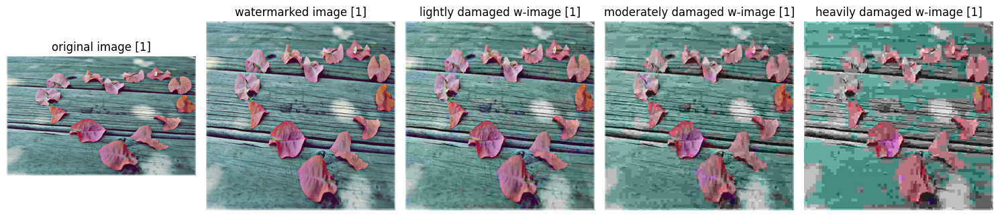

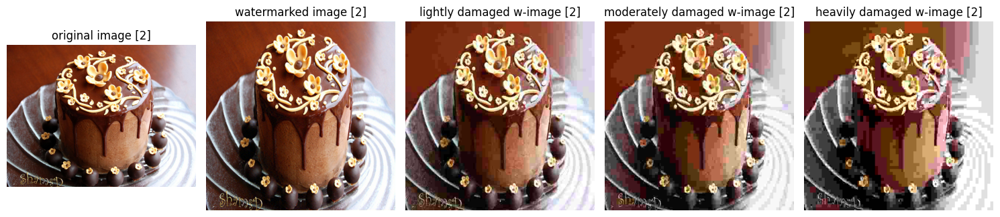

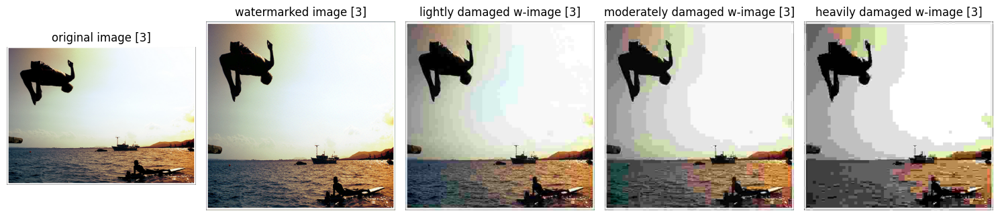

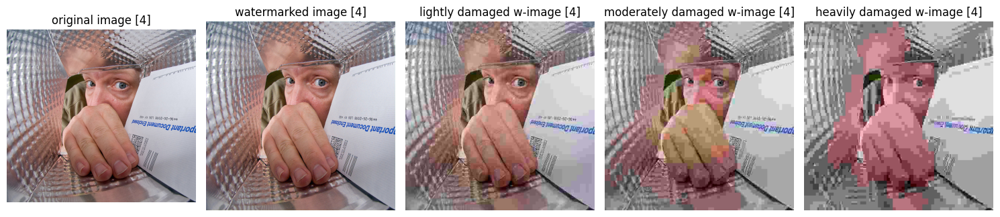

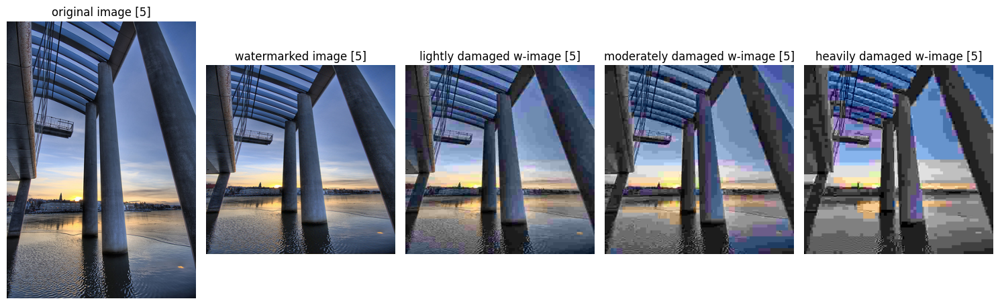

In [ ]:
for i in range(6):
    plot_side_by_side(original_images, watermarked_images, distorted_images[0], distorted_images[1], distorted_images[2], i)

In [ ]:
decoded_dict = {}

for i, name in enumerate(['light damage', 'medium damage', 'heavy damage']):
    print('\n\n', name)
    decoded_secrets_stable_sig = []
    decoded_dict[name] = []
    for j in range(6):
        clip_img = noised_images[i][j]
        ft = decoder(default_transform(clip_img.astype(np.float32)).unsqueeze(0).to(device))
        decoded_msg = ft > 0
        decoded_msg = decoded_msg.squeeze(0).cpu().numpy().astype(int)

        decoded_dict[name].append(decoded_msg)

        sim_idx = calculate_similarity(decoded_msg, msg_ori[0].numpy())
        print(f"{sim_idx:.3f}%")



 light damage
56.250%
58.333%
52.083%
47.917%
47.917%
52.083%


 medium damage
47.917%
50.000%
45.833%
43.750%
47.917%
50.000%


 heavy damage
52.083%
54.167%
50.000%
45.833%
50.000%
52.083%


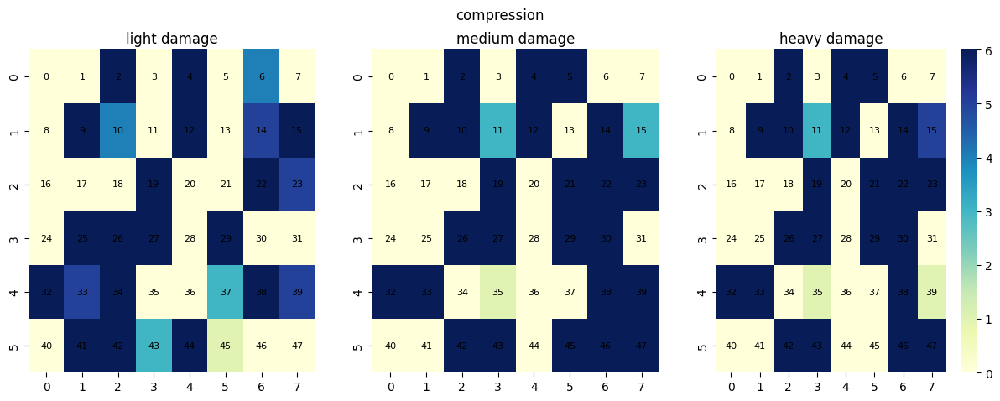

In [ ]:
plot_decoding_errors(decoded_dict, 'compression')